# Exploratory Data Analysis (EDA) - Pre Pre-Processing

### **0. Importing the libraries**

In [133]:
import numpy as np
import pandas as pd
from datetime import datetime # to get the current datetime

import matplotlib.pyplot as plt # to make plots (histograms, etc...)
import seaborn as sns
import plotly.express as px
import folium
import branca.colormap as cm  # for color mapping based on data values

import ast # transform the strings into a list

from sklearn.preprocessing import RobustScaler
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from kneed import KneeLocator # to automatically find the "knee" for the dbscan's parameter
from sklearn.decomposition import PCA

In [134]:
# Show all columns when displaying a DataFrame
pd.set_option('display.max_columns', None)

# Optional: Also show more rows if needed
pd.set_option('display.max_rows', 100)

# shows all columns
pd.set_option("display.max_columns", None)

# prevents wrapping
pd.set_option("display.width", 1000)

In [135]:
pd.set_option('display.max_colwidth', None)

### **1. Initial Data Understanding**

#### 1.0) Load the datasets

In [136]:
customer_basket = pd.read_csv('../data/raw/customer_basket.csv')
customer_info = pd.read_csv('../data/raw/customer_info.csv', index_col=["customer_id"])

customer_info = customer_info.drop("Unnamed: 0", axis='columns')

#### 1.1) Print shapes, column names, sample rows

In [137]:
print(f"The customer basket dataset has {customer_basket.shape[0]} rows and {customer_basket.shape[1]} columns.")
print(f"The customer info dataset has {customer_info.shape[0]} rows and {customer_info.shape[1]} columns.")

The customer basket dataset has 100000 rows and 3 columns.
The customer info dataset has 34060 rows and 24 columns.


In [138]:
customer_info.head(5)

,customer_name,customer_gender,customer_birthdate,kids_home,teens_home,number_complaints,distinct_stores_visited,lifetime_spend_groceries,lifetime_spend_electronics,typical_hour,lifetime_spend_vegetables,lifetime_spend_nonalcohol_drinks,lifetime_spend_alcohol_drinks,lifetime_spend_meat,lifetime_spend_fish,lifetime_spend_hygiene,lifetime_spend_videogames,lifetime_spend_petfood,lifetime_total_distinct_products,percentage_of_products_bought_promotion,year_first_transaction,loyalty_card_number,latitude,longitude
customer_id,,,,,,,,,,,,,,,,,,,,,,,,
29930,April Clark,female,01/15/1972 02:27 PM,2.0,2.0,1.0,4.0,7789.0,5601.0,13.0,726.0,962.0,1213.0,1598.0,1894.0,457.0,412.0,428.0,386.0,0.158741,2018.0,NaN,38.721807,-9.125534
6813,Bsc. Paul Ketchum,male,07/31/1944 10:53 AM,0.0,1.0,0.0,4.0,8653.0,35.0,14.0,792.0,102.0,104.0,741.0,346.0,394.0,75.0,226.0,73.0,1.227890,2013.0,971840.0,38.734668,-9.163533
39451,Mary Downing,female,11/13/1989 02:11 PM,2.0,3.0,0.0,7.0,15605.0,4275.0,14.0,1585.0,980.0,1872.0,1323.0,1971.0,920.0,335.0,192.0,319.0,0.101598,2011.0,NaN,38.787126,-9.147077
21557,Manuel Kueny,male,08/09/1976 06:23 AM,0.0,0.0,1.0,1.0,13440.0,16366.0,14.0,28.0,269.0,1855.0,939.0,785.0,139.0,679.0,270.0,221.0,0.259943,2009.0,NaN,38.741816,-9.159700
16415,Phd. Curtis Tharp,male,07/11/1966 08:12 AM,1.0,1.0,1.0,5.0,49250.0,3197.0,14.0,258.0,726.0,547.0,983.0,1492.0,1046.0,112.0,144.0,244.0,0.317822,2012.0,925367.0,38.785921,-9.149221


In [139]:
customer_basket.head(5)

,invoice_id,list_of_goods,customer_id
0,5062209,"['megaman zero 3', 'energy bar', 'pokemon violet', 'airpods', 'fresh bread', 'pancakes', 'brownies', 'energy drink', 'champagne', 'red wine', 'bluetooth headphones', 'protein bar', 'metroid fusion']",4925
1,4272512,"['black beer', 'bramble', 'laptop', 'pokemon violet', 'airpods', 'gadget for tiktok streaming', 'ring light', 'ratchet & clank', 'pancakes', 'energy drink', 'gums', 'protein bar']",19046
2,7121052,"['soup', 'shallot', 'cake', 'fresh bread', 'cream', 'carrots', 'babies food', 'ham', 'cookies', 'salad', 'tomato sauce', 'cooking oil', 'tea']",10318
3,5847748,"['soup', 'cooking oil', 'cereals', 'oil', 'dog food', 'deodorant', 'tomatoes', 'yogurt cake', 'pet food', 'salmon', 'olive oil', 'fresh tuna', 'tea']",27283
4,6336114,"['eggplant', 'mint green tea', 'oil', 'bacon', 'toilet paper', 'shrimp', 'brownies', 'pancakes', 'champagne', 'spinach', 'cologne', 'chicken', 'barbecue sauce', 'fresh tuna']",16072


In [187]:
customer_basket["invoice_id"].is_unique

False

In [141]:
customer_basket["customer_id"].is_unique

False

**For the preprocessing**:Thus, we have duplicate rows

In [142]:
customer_basket[customer_basket["invoice_id"].duplicated(keep=False)]

,invoice_id,list_of_goods,customer_id
365,10756514,"['candy bars', 'cake', 'french fries', 'oil', 'parmesan cheese', 'pasta', 'cookies', 'cooking oil']",15253
366,10756514,"['candy bars', 'cake', 'french fries', 'oil', 'parmesan cheese', 'pasta', 'cookies', 'cooking oil']",33632
485,9407916,"['light cream', 'cottage cheese', 'laptop', 'frozen smoothie', 'french fries', 'flax seed', 'strawberries', 'champagne', 'escalope', 'fresh tuna']",3717
486,9407916,"['light cream', 'cottage cheese', 'laptop', 'frozen smoothie', 'french fries', 'flax seed', 'strawberries', 'champagne', 'escalope', 'fresh tuna']",8167
631,9863418,"['energy drink', 'blueberries', 'green beans', 'iMac', 'mint']",33535
...,...,...,...
91494,4124129,"['cider', 'dessert wine', 'white wine', 'half-life: alyx', 'french wine']",30163
91875,2280114,"['candy bars', 'soup', 'cake', 'oil', 'fresh bread', 'cream', 'babies food', 'pet food', 'cooking oil']",5966
91876,2280114,"['candy bars', 'soup', 'cake', 'oil', 'fresh bread', 'cream', 'babies food', 'pet food', 'cooking oil']",30813
92337,10587899,"['whole wheat rice', 'cotton buds', 'bacon', 'final fantasy XX', 'oil', 'milk', 'champagne', 'babies food', 'pet food', 'ratchet & clank 3', 'eggs', 'ratchet & clank 2', 'cauliflower']",6652


**For the preprocessing**: Regarding the customer_basket dataset, when the same items are bought in two different instances, these are attributed different invoices. Thus we cannot make invoice_id our index column

#### 1.2) Check basic dtypes and missing values

For the customer_info dataset:

In [143]:
customer_info.info()

<class 'pandas.core.frame.DataFrame'>
Index: 34060 entries, 29930 to 22050
Data columns (total 24 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   customer_name                            34060 non-null  object 
 1   customer_gender                          34060 non-null  object 
 2   customer_birthdate                       33719 non-null  object 
 3   kids_home                                33311 non-null  float64
 4   teens_home                               33277 non-null  float64
 5   number_complaints                        33038 non-null  float64
 6   distinct_stores_visited                  33379 non-null  float64
 7   lifetime_spend_groceries                 34060 non-null  float64
 8   lifetime_spend_electronics               34060 non-null  float64
 9   typical_hour                             32698 non-null  float64
 10  lifetime_spend_vegetables                33038 

In [144]:
missing_customer_info = pd.DataFrame({
    'Missing Count': customer_info.isnull().sum(),
    'Missing %': round(customer_info.isnull().mean() * 100, 2)
})

In [189]:
missing_customer_info

,Missing Count,Missing %
customer_name,0,0.00
customer_gender,0,0.00
customer_birthdate,341,1.00
kids_home,749,2.20
teens_home,783,2.30
number_complaints,1022,3.00
distinct_stores_visited,681,2.00
lifetime_spend_groceries,0,0.00
lifetime_spend_electronics,0,0.00
typical_hour,1362,4.00


**For the preprocessing**: 32% of customers have a missing value at loyalty_card_number, meaning they probably don't have one.

For the customer_basket dataset:

In [146]:
customer_basket.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 3 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   invoice_id     100000 non-null  int64 
 1   list_of_goods  100000 non-null  object
 2   customer_id    100000 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 2.3+ MB


In [188]:
missing_customer_basket = pd.DataFrame({
    'Missing Count': customer_basket.isnull().sum(),
    'Missing %': round(customer_basket.isnull().mean() * 100, 2)
})

In [148]:
missing_customer_basket

,Missing Count,Missing %
invoice_id,0,0.0
list_of_goods,0,0.0
customer_id,0,0.0


### **2. Univariate Exploration**

#### 2.0) Creating an *age* variable

##### 2.0.1) Altering the customer_birthdate column to datetime format

In [149]:
customer_info["customer_birthdate"] = pd.to_datetime(customer_info["customer_birthdate"], format="%m/%d/%Y %I:%M %p")

##### 2.0.2) Creating the *age* column throught the differece between the current date and the birth date

In [1]:
today = datetime.now()
customer_info["age"] = customer_info["customer_birthdate"].apply(lambda x: today.year - x.year - ((today.month, today.day) < (x.month, x.day))) # works because True = 1 and False = 0

NameError: name 'datetime' is not defined

#### 2.1) Histograms of numerical variables

##### 2.1.1) customer_info dataset

In [151]:
numerical_customer_info = customer_info.select_dtypes(include='number')

In [152]:
# Create a function to make a histogram of every single variable

def histogramer(dataset, feature, bins=10):
    # fazer bins para valores unicos
    # criar o parametro opcional "bins" (default é 20)
    # fazer a docstring
    """
    """
    if bins == "unique":
        unique_values = dataset[feature].nunique()
        bins = unique_values
    
    sns.histplot(dataset[feature], bins=bins, kde=True, edgecolor='black')
    plt.title(f'Histogram for {feature}')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.show()
    

kids_home


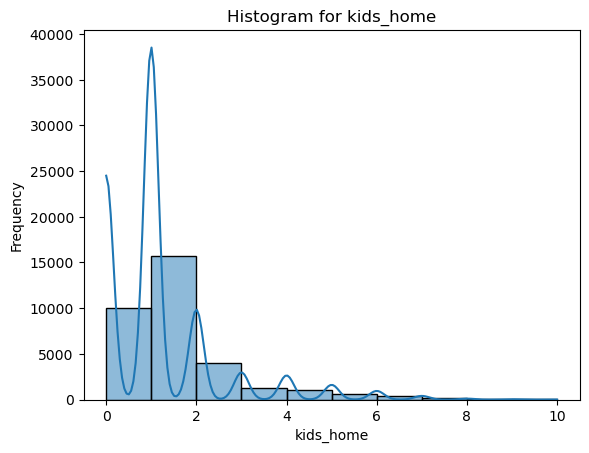

teens_home


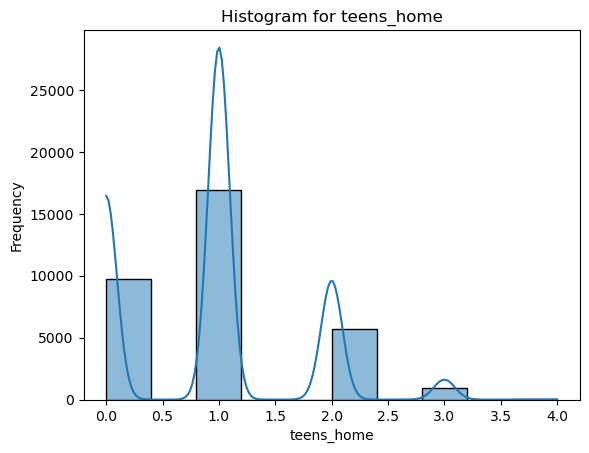

number_complaints


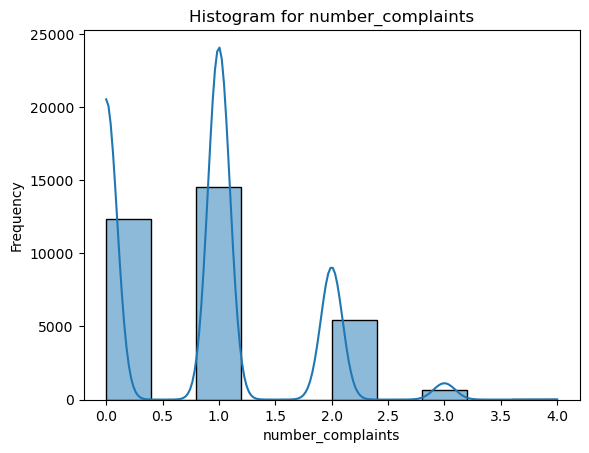

distinct_stores_visited


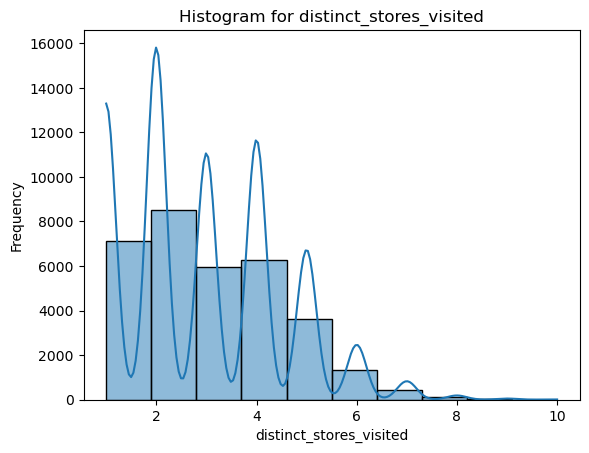

lifetime_spend_groceries


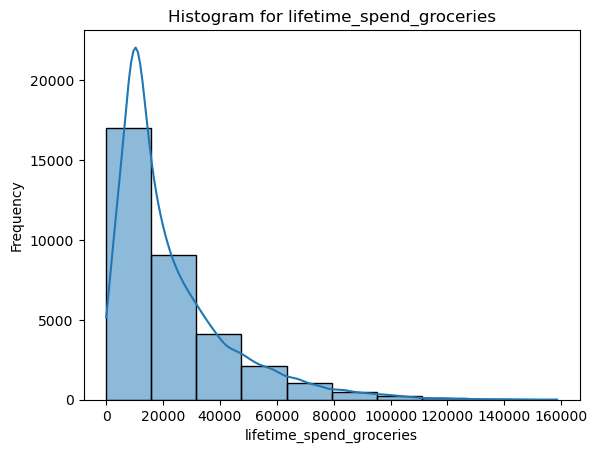

lifetime_spend_electronics


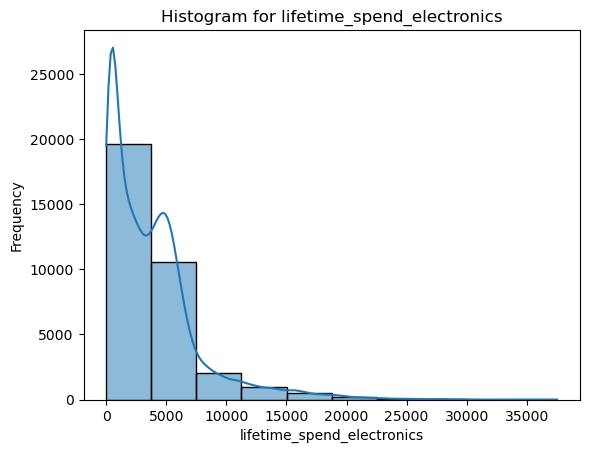

typical_hour


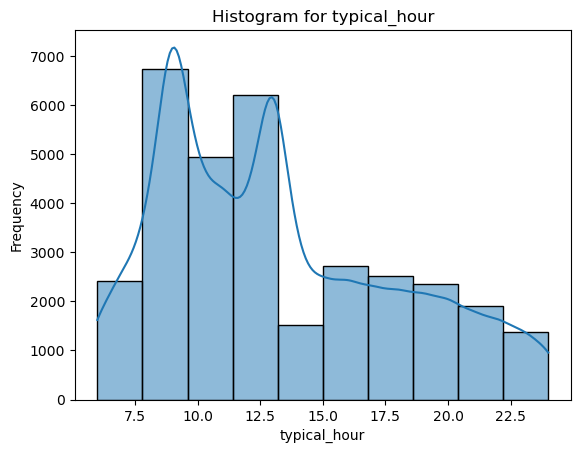

lifetime_spend_vegetables


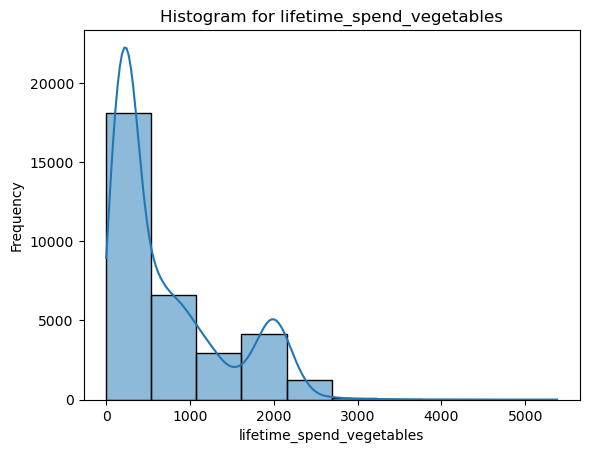

lifetime_spend_nonalcohol_drinks


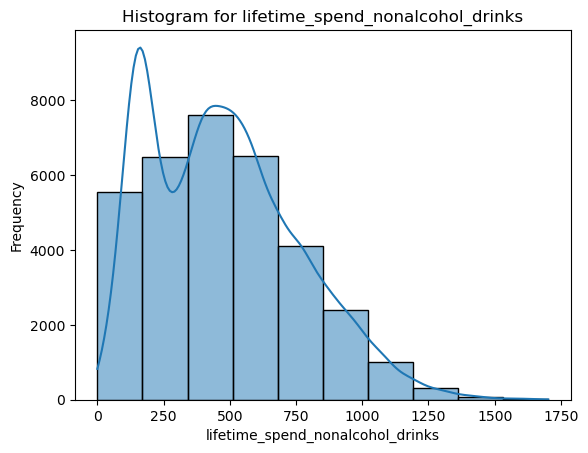

lifetime_spend_alcohol_drinks


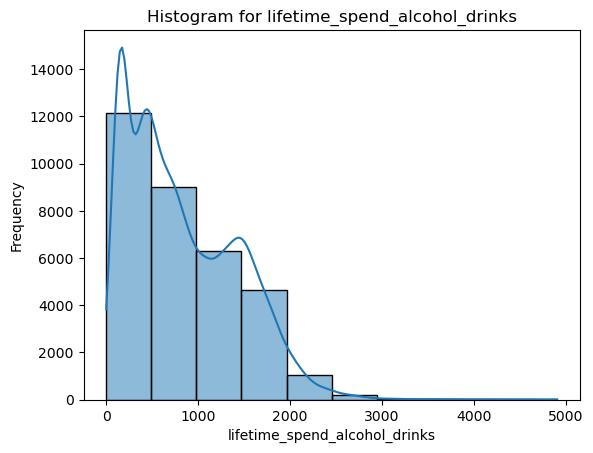

lifetime_spend_meat


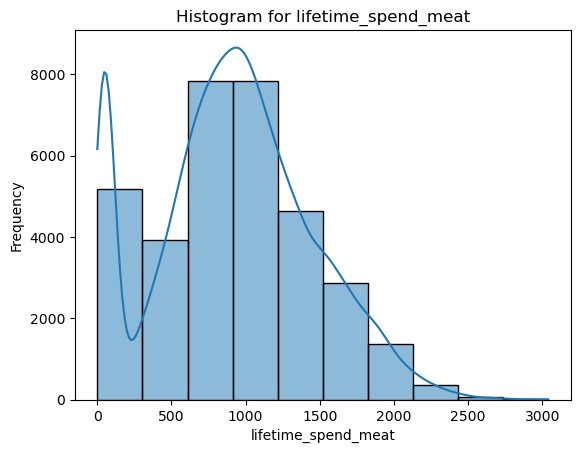

lifetime_spend_fish


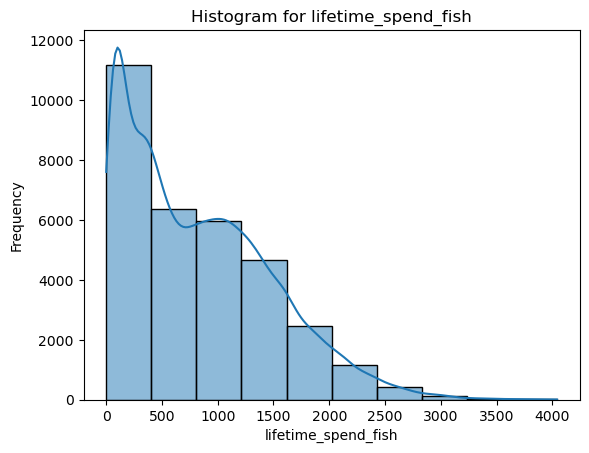

lifetime_spend_hygiene


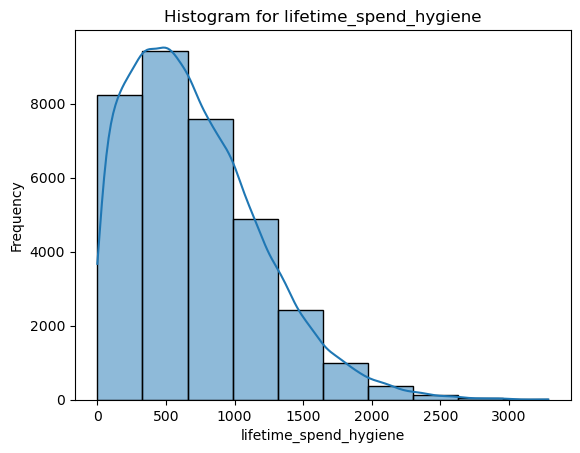

lifetime_spend_videogames


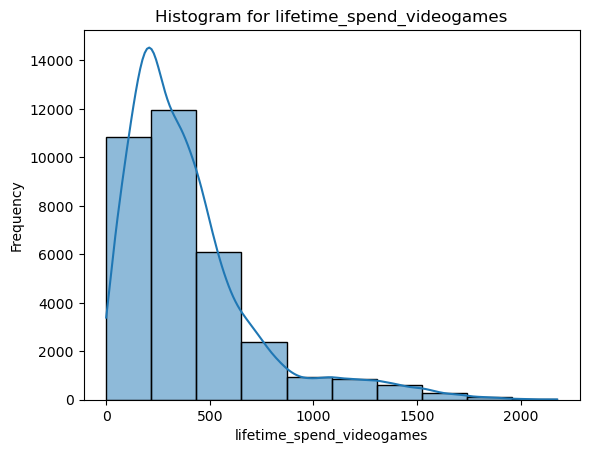

lifetime_spend_petfood


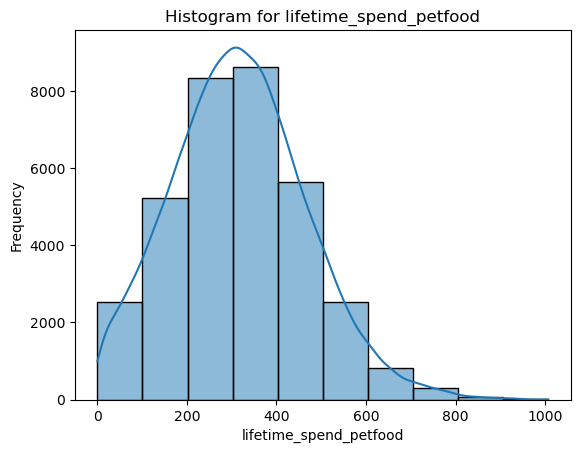

lifetime_total_distinct_products


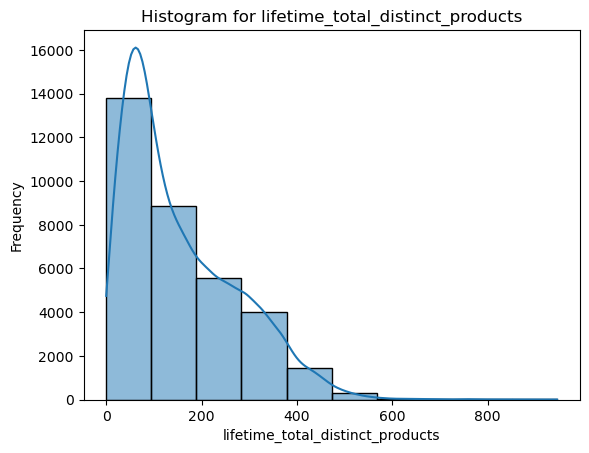

percentage_of_products_bought_promotion


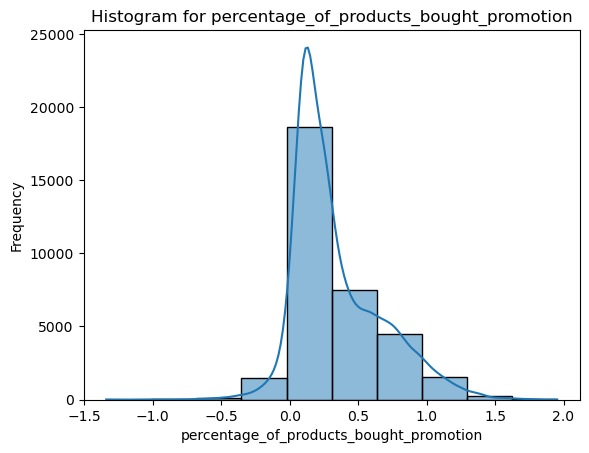

year_first_transaction


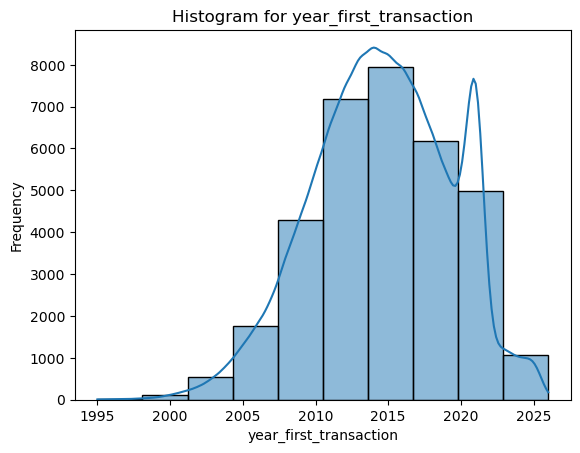

loyalty_card_number


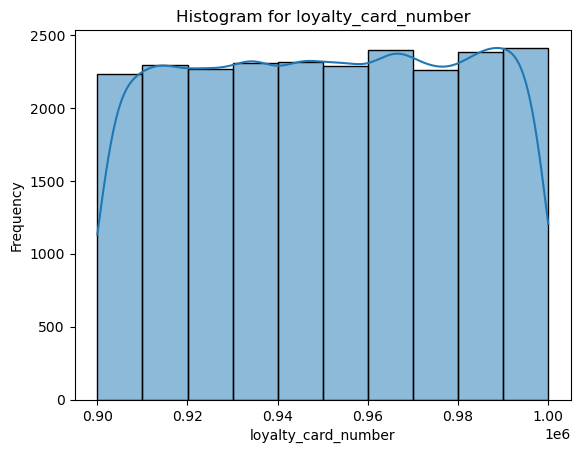

latitude


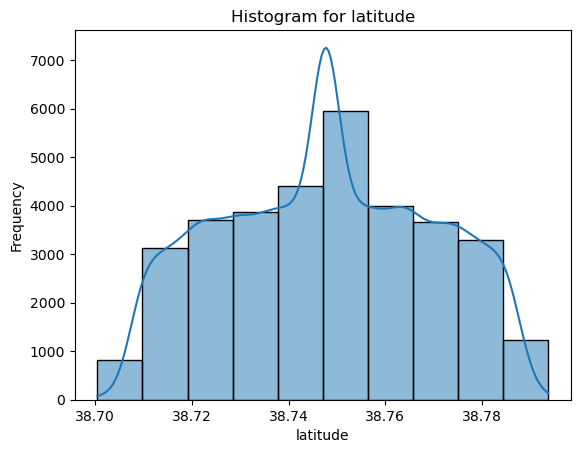

longitude


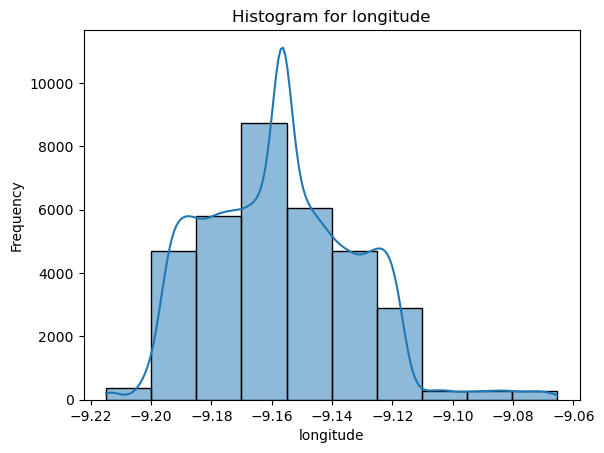

age


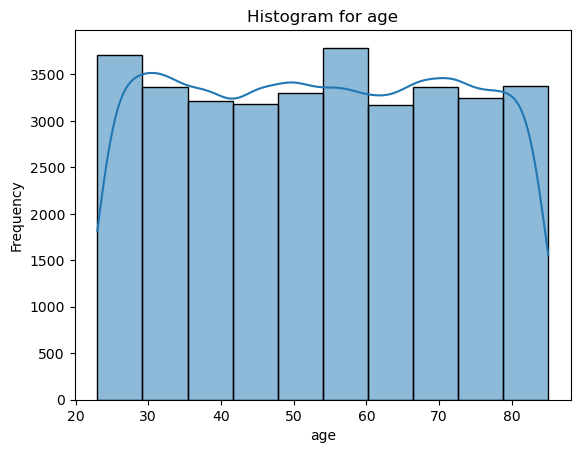

In [153]:
for feature in numerical_customer_info:
    print(feature)
    histogramer(numerical_customer_info, feature)

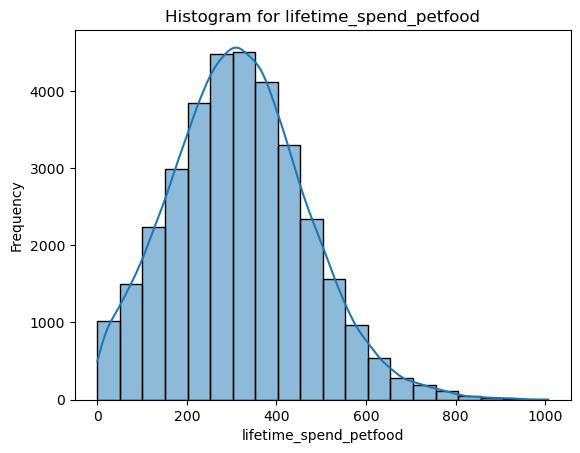

In [154]:
histogramer(customer_info, "lifetime_spend_petfood", bins=20)

##### 2.1.2) customer_basket dataset

In [155]:
type(customer_basket["list_of_goods"][0])

str

the list_of_goods column is all in **string** format, we first have to turn it into **lists**

In [156]:
customer_basket["list_of_goods"] = customer_basket["list_of_goods"].apply(ast.literal_eval)

In [157]:
type(customer_basket["list_of_goods"][0])

list

now we create a function that returns a sorted (using merge sort) dictionary of the most purchased items

In [158]:
def merge_sort_by_value(items):
    if len(items) <= 1:
        return items

    mid = len(items) // 2
    left = merge_sort_by_value(items[:mid])
    right = merge_sort_by_value(items[mid:])

    return merge_by_value(left, right)

def merge_by_value(left, right):
    result = []
    i = j = 0

    while i < len(left) and j < len(right):
        if left[i][1] >= right[j][1]: 
            result.append(left[i])
            i += 1
        else:
            result.append(right[j])
            j += 1

    result.extend(left[i:])
    result.extend(right[j:])
    return result

def sort_dict_by_value(d):
    items = list(d.items())
    sorted_items = merge_sort_by_value(items)
    return dict(sorted_items)

In [159]:
def purchase_counter(series_of_lt):

    unsorted_dic = {}
    for lt in series_of_lt:
        for item in lt:
            if item not in unsorted_dic.keys():
                unsorted_dic[item] = 1
            else:
                unsorted_dic[item] += 1

    sorted_dic = sort_dict_by_value(unsorted_dic)
    return sorted_dic

In [160]:
# funçao para fazer histograma tp top 10, top 30, do 50 ao 60, etc...

now we make a function that'll return a histogram with the values of a provided range of items (ex: top 10 most bought; from 20th to 50th most bought; etc...)

In [161]:
def histogram_top(dic, nfrom=0, nto=10):

    # convert the dictionary into a dataframe and slicing it (the dictionary)
    items = list(dic.items())[nfrom:nto]
    temp_df = pd.DataFrame([dict(items)]).T.reset_index()
    temp_df.columns = ['product', 'count']

    # plotting the histogram
    sns.barplot(x='product', y='count', data=temp_df)
    plt.xticks(rotation=45, ha='right')
    plt.title('Top Product Counts')
    plt.tight_layout()
    plt.show()

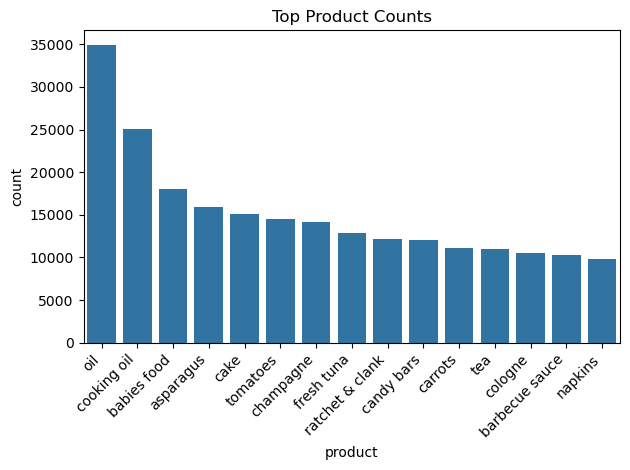

In [162]:
histogram_top(purchase_counter(customer_basket["list_of_goods"]), 0, 15)

#### 2.2) Boxplots to check for outliers

In [163]:
# Create a function to make a boxplot of every single variable

def boxplotter(dataset, feature):
    # fazer a docstring
    """
    """
    px.box(data_frame=dataset, x=feature, title=f'Boxplot for {feature}').show()
    

In [164]:
for feature in numerical_customer_info:
    boxplotter(numerical_customer_info, feature)

**For the preprocessing**: percentage_of_products_bought_promotion is a percentage, yet has negative values

#### 2.3) Notes for the preprocessing

- We have duplicate rows on customer_basket

- Regarding the customer_basket dataset, when the same items are bought in two different instances, these are attributed different invoices. Thus we cannot make invoice_id our index column

- 32% of customers have a missing value at loyalty_card_number, meaning they probably don't have one.

- percentage_of_products_bought_promotion is a percentage, yet has negative values

### **3. Multivariate Exploration**

#### 3.1) Correlation Heatmap for numeric variables

In [165]:
numerical_customer_info

,kids_home,teens_home,number_complaints,distinct_stores_visited,lifetime_spend_groceries,lifetime_spend_electronics,typical_hour,lifetime_spend_vegetables,lifetime_spend_nonalcohol_drinks,lifetime_spend_alcohol_drinks,lifetime_spend_meat,lifetime_spend_fish,lifetime_spend_hygiene,lifetime_spend_videogames,lifetime_spend_petfood,lifetime_total_distinct_products,percentage_of_products_bought_promotion,year_first_transaction,loyalty_card_number,latitude,longitude,age
customer_id,,,,,,,,,,,,,,,,,,,,,,
29930,2.0,2.0,1.0,4.0,7789.0,5601.0,13.0,726.0,962.0,1213.0,1598.0,1894.0,457.0,412.0,428.0,386.0,0.158741,2018.0,NaN,38.721807,-9.125534,53.0
6813,0.0,1.0,0.0,4.0,8653.0,35.0,14.0,792.0,102.0,104.0,741.0,346.0,394.0,75.0,226.0,73.0,1.227890,2013.0,971840.0,38.734668,-9.163533,80.0
39451,2.0,3.0,0.0,7.0,15605.0,4275.0,14.0,1585.0,980.0,1872.0,1323.0,1971.0,920.0,335.0,192.0,319.0,0.101598,2011.0,NaN,38.787126,-9.147077,35.0
21557,0.0,0.0,1.0,1.0,13440.0,16366.0,14.0,28.0,269.0,1855.0,939.0,785.0,139.0,679.0,270.0,221.0,0.259943,2009.0,NaN,38.741816,-9.159700,48.0
16415,1.0,1.0,1.0,5.0,49250.0,3197.0,14.0,258.0,726.0,547.0,983.0,1492.0,1046.0,112.0,144.0,244.0,0.317822,2012.0,925367.0,38.785921,-9.149221,58.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37071,1.0,1.0,0.0,2.0,62321.0,5250.0,16.0,813.0,528.0,1524.0,687.0,1687.0,1048.0,379.0,258.0,163.0,0.162331,2018.0,NaN,38.750813,-9.103808,26.0
27422,1.0,1.0,0.0,3.0,16084.0,3796.0,13.0,502.0,748.0,694.0,1200.0,568.0,949.0,263.0,319.0,379.0,0.614179,2019.0,985393.0,38.745020,-9.169168,40.0
39540,1.0,0.0,1.0,2.0,14631.0,8784.0,17.0,402.0,262.0,484.0,509.0,1472.0,368.0,804.0,110.0,228.0,0.535617,2018.0,NaN,38.767834,-9.172368,24.0


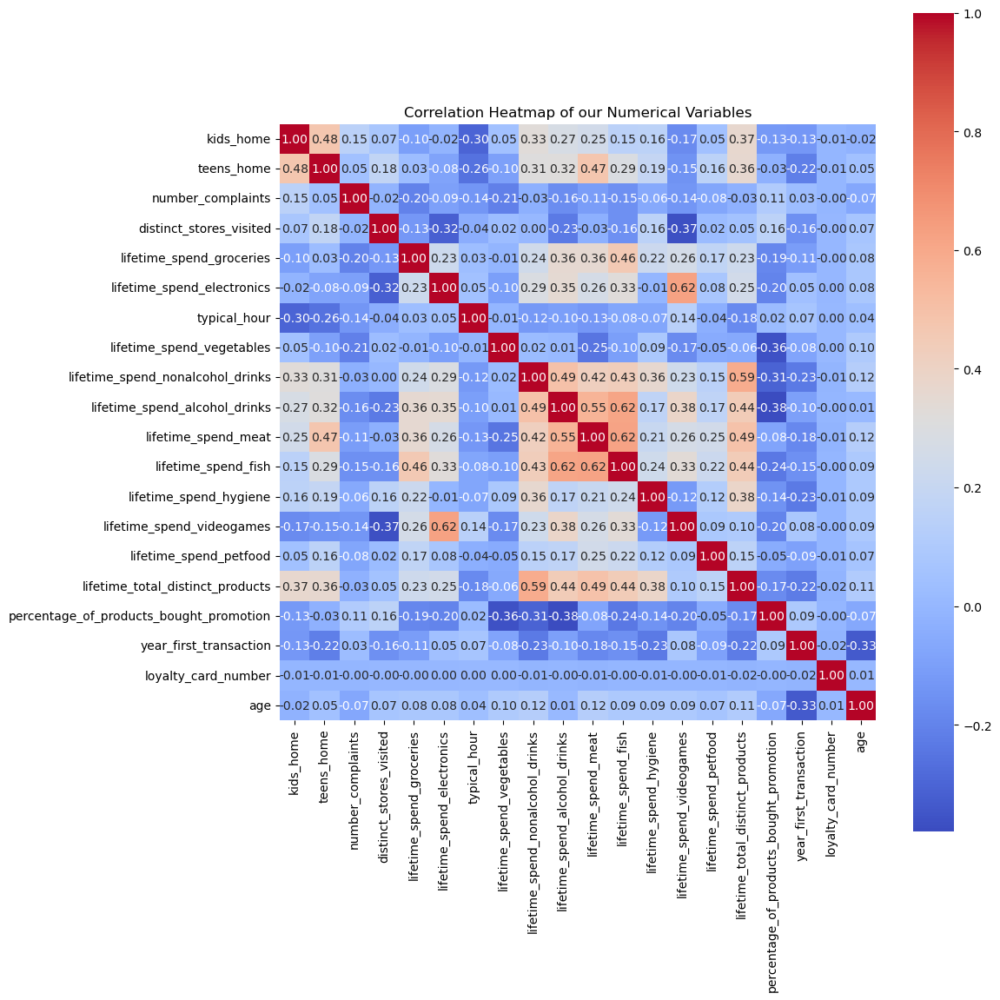

In [166]:
corr_matrix = numerical_customer_info.drop(["latitude","longitude"], axis=1).corr()

plt.figure(figsize=(12, 12))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title('Correlation Heatmap of our Numerical Variables')
plt.tight_layout()
plt.show()

We can observe some relevant (above 0.5) correlations between:
- lifetime_total_distinct_products **and** lifetime_spend_nonalcohol_drinks
- lifetime_spend_videogames **and** lifetime_spend_electronics
- lifetime_spend_meat **and** lifetime_spend_alcohol_drinks
- lifetime_spend_fish **and** lifetime_spend_alcohol_drinks
- lifetime_spend_fish **and** lifetime_spend_meat

#### 3.2) Scatter plots / Pair plots

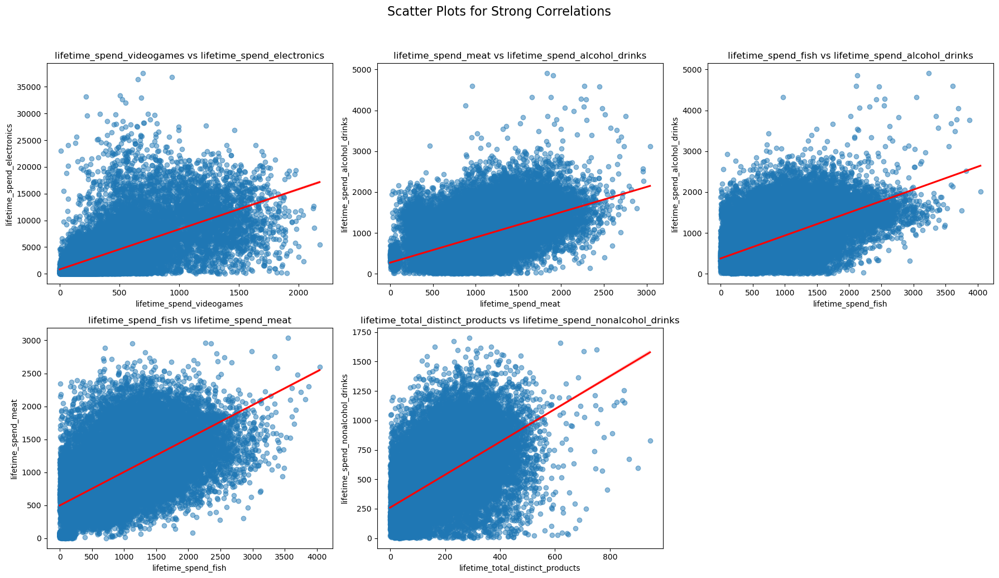

In [167]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define the strongly correlated pairs (from your heatmap)
strong_pairs = [
    ("lifetime_spend_videogames", "lifetime_spend_electronics"),
    ("lifetime_spend_meat", "lifetime_spend_alcohol_drinks"),
    ("lifetime_spend_fish", "lifetime_spend_alcohol_drinks"),
    ("lifetime_spend_fish", "lifetime_spend_meat"),
    ("lifetime_total_distinct_products", "lifetime_spend_nonalcohol_drinks")
]

# Create scatter plots
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18, 10))
axes = axes.flatten()

for i, (x, y) in enumerate(strong_pairs):
    sns.regplot(data=customer_info, x=x, y=y, ax=axes[i], scatter_kws={'alpha':0.5}, line_kws={"color":"red"})
    axes[i].set_title(f"{x} vs {y}")

# Hide unused subplot
for j in range(len(strong_pairs), len(axes)):
    fig.delaxes(axes[j])

plt.suptitle("Scatter Plots for Strong Correlations", fontsize=16, y=1.03)
plt.tight_layout()
plt.show()


#### 3.3.1) Spider Chart
Making a spider chart to analyse the portion of money that is spend on each category (meat, fish, vegetables, etc...). Leaving out groceries and eletronics as these values are way larger, affecting the visualization of the other features.

In [168]:
# Get all columns that start with 'lifetime_spend_'
lifetime_cols = [col for col in customer_info.columns if col.startswith("lifetime_") and col not in ["lifetime_spend_electronics", "lifetime_spend_groceries"]]

cols_to_keep = lifetime_cols + ["age"]

# Subset the DataFrame
subset_df = customer_info[cols_to_keep]

In [169]:
def get_age_range(age, age_groups):
    for start, end in age_groups:
        if start <= age <= end:
            return f"{start}-{end}"

def plot_spending_spider_charts(dataset, frequency):
    """
    
    """
    
    # Check inputs, if frequency ins't an int greater than zero, or "age" isn't in the dataset, it raises an error
    if not isinstance(frequency, int) or frequency <= 0:
        raise ValueError("Parameter 'frequency' must be a positive integer.")
    
    if "age" not in dataset.columns:
        raise ValueError("The dataset must contain an 'age' column.")
    
    # creating df1 - where we store all the percentages 
    spend_cols = [col for col in dataset.columns if col != "age"]
    df1 = dataset[spend_cols + ["age"]]

    # Compute total and percentage per category
    df1["total_spend"] = df1[spend_cols].sum(axis=1)
    for col in spend_cols:
        df1[col + "_pct"] = df1[col] / df1["total_spend"]

    # dropping the undisered columns
    for col in df1:
        if "_pct" not in col and col not in ["age", "total_spend"]:
            df1 = df1.drop(col, axis=1)

    # getting the groups of ages
    min_age = int(dataset["age"].min())
    max_age = int(dataset["age"].max())
    age_groups = [(i, i + frequency - 1) for i in range(min_age, max_age, frequency)]

    # create an "age range" column for df1 and aggregate by it, creating df2
    df1["age_range"] = df1["age"].apply(lambda x: get_age_range(x, age_groups))
    df2 = df1.groupby("age_range").mean(numeric_only=True).drop(columns=["age", "total_spend"])

    # radar chart plotting
    categories = df2.columns.tolist()
    N = len(categories)
    
    # setting up the radar chart angles
    angles = np.linspace(0, 2 * np.pi, N, endpoint=False).tolist()
    angles += angles[:1]  # to close the loop

    # plotting for each age range
    fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))
    
    for index, row in df2.iterrows():
        values = row.tolist()
        values += values[:1]  # close the loop
        ax.plot(angles, values, label=index, linewidth=2)

    # adding the labels
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels([col.replace("_pct", "").replace("lifetime_spend_", "").replace("_", " ").title() for col in categories], fontsize=10)
    ax.set_yticklabels([])
    ax.set_title("Average Spending by Age Range", size=14)
    ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))

    plt.tight_layout()
    plt.show()

    


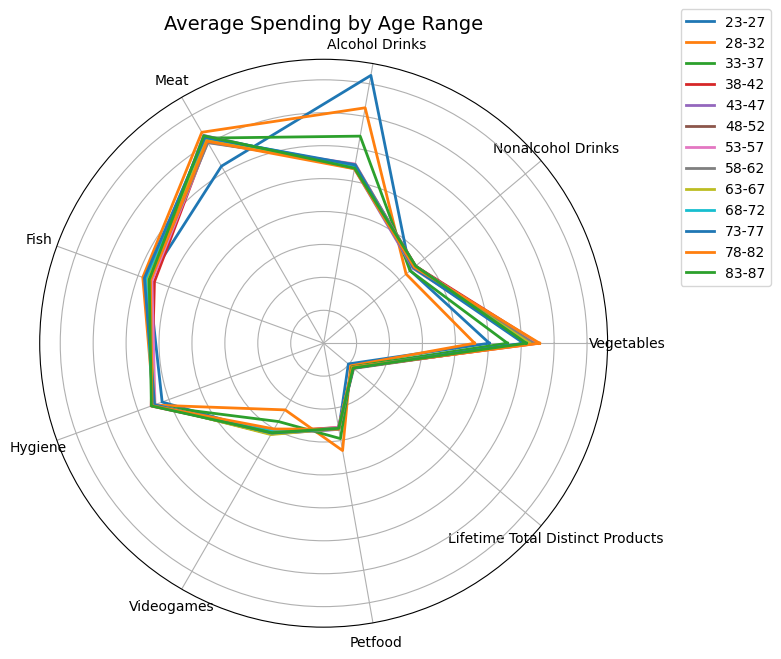

In [170]:
plot_spending_spider_charts(subset_df, 5)

We can observe a clear pattern for **alcohol** consumption, the closer to the 23-27 age range, meaning, the younger the customers are, the more alcohol will be purchased. For **meat**, the distribution differens only for the younger age range, showing they purchase less of these items. For **fish**, **hygiene**, **distinct products** and **nonalcohol drinks**, the distribution is very similar across all age ranges. For **videogames** and **petfood**, the older age groups seem to differ the most buying less of the former and more of the latter. For **vegetables**, it appears that older people consume more of these.

For cases where older people buy more of a given product, it may be due to the fact that these variables are a lifetime spend, and older people have spent more time buying these products. Following the same logic, it may be that younger people now are purchasing far more alcohol than before, since they far outdo the bigger age groups

#### 3.3.2) Histograms
Making a histogram for the remaining variables that could not be observed

In [171]:
customer_info.head()

,customer_name,customer_gender,customer_birthdate,kids_home,teens_home,number_complaints,distinct_stores_visited,lifetime_spend_groceries,lifetime_spend_electronics,typical_hour,lifetime_spend_vegetables,lifetime_spend_nonalcohol_drinks,lifetime_spend_alcohol_drinks,lifetime_spend_meat,lifetime_spend_fish,lifetime_spend_hygiene,lifetime_spend_videogames,lifetime_spend_petfood,lifetime_total_distinct_products,percentage_of_products_bought_promotion,year_first_transaction,loyalty_card_number,latitude,longitude,age
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,
29930,April Clark,female,1972-01-15 14:27:00,2.0,2.0,1.0,4.0,7789.0,5601.0,13.0,726.0,962.0,1213.0,1598.0,1894.0,457.0,412.0,428.0,386.0,0.158741,2018.0,NaN,38.721807,-9.125534,53.0
6813,Bsc. Paul Ketchum,male,1944-07-31 10:53:00,0.0,1.0,0.0,4.0,8653.0,35.0,14.0,792.0,102.0,104.0,741.0,346.0,394.0,75.0,226.0,73.0,1.227890,2013.0,971840.0,38.734668,-9.163533,80.0
39451,Mary Downing,female,1989-11-13 14:11:00,2.0,3.0,0.0,7.0,15605.0,4275.0,14.0,1585.0,980.0,1872.0,1323.0,1971.0,920.0,335.0,192.0,319.0,0.101598,2011.0,NaN,38.787126,-9.147077,35.0
21557,Manuel Kueny,male,1976-08-09 06:23:00,0.0,0.0,1.0,1.0,13440.0,16366.0,14.0,28.0,269.0,1855.0,939.0,785.0,139.0,679.0,270.0,221.0,0.259943,2009.0,NaN,38.741816,-9.159700,48.0
16415,Phd. Curtis Tharp,male,1966-07-11 08:12:00,1.0,1.0,1.0,5.0,49250.0,3197.0,14.0,258.0,726.0,547.0,983.0,1492.0,1046.0,112.0,144.0,244.0,0.317822,2012.0,925367.0,38.785921,-9.149221,58.0


In [172]:
def bar_charter(dataset, frequency, variable):

    # Input validation
    if "age" not in dataset.columns:
        raise ValueError("The dataset must contain an 'age' column.")
    if variable not in dataset.columns:
        raise ValueError(f"The dataset must contain the '{variable}' column.")
    if not isinstance(frequency, int) or frequency <= 0:
        raise ValueError("Parameter 'frequency' must be a positive integer.")

    # Generate age groups
    min_age = int(dataset["age"].min())
    max_age = int(dataset["age"].max())
    age_groups = [(i, i + frequency - 1) for i in range(min_age, max_age + 1, frequency)]

    # Assign age_range labels using your existing function
    dataset["age_range"] = dataset["age"].apply(lambda x: get_age_range(x, age_groups))

    # Group by age_range and calculate average value
    grouped = dataset.groupby("age_range")[variable].mean().sort_index()

    # Plotting
    plt.figure(figsize=(10, 6))
    plt.bar(grouped.index, grouped.values, color="skyblue", edgecolor="black")
    plt.xlabel("Age Range")
    plt.ylabel(f"Average {variable}")
    plt.title(f"Average {variable} by Age Range")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

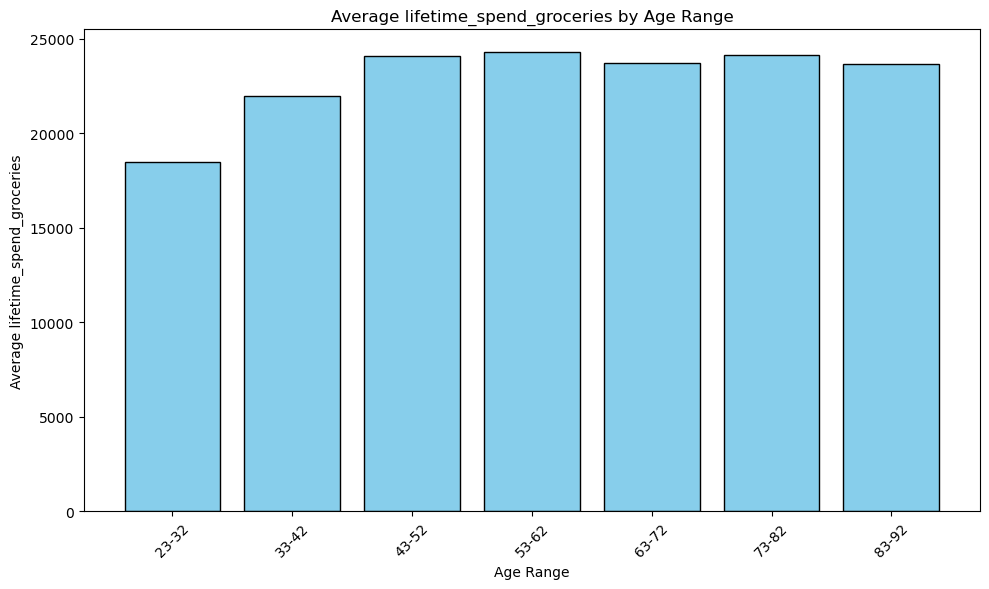

In [173]:
bar_charter(customer_info, 10, "lifetime_spend_groceries")

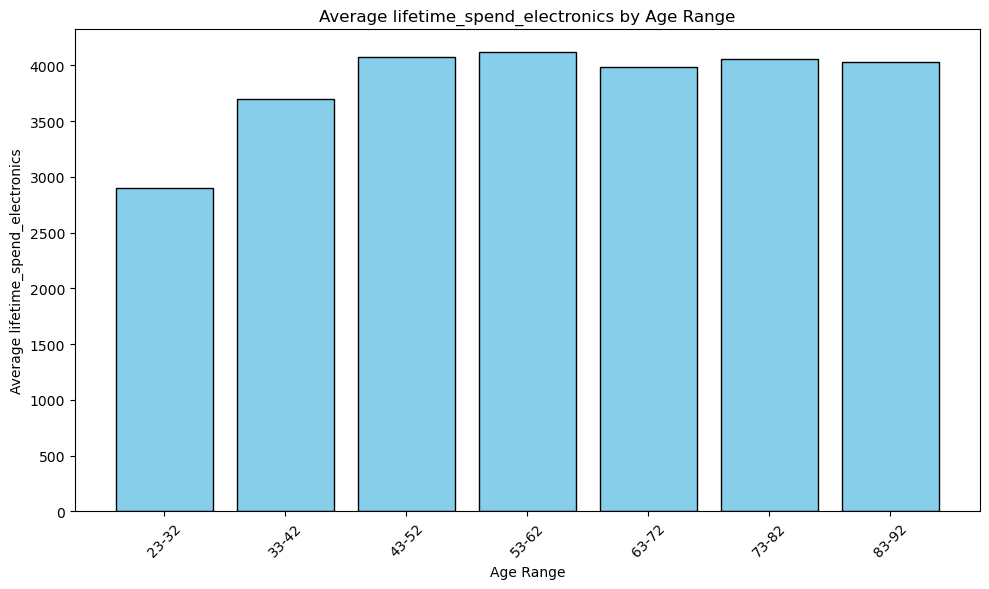

In [174]:
bar_charter(customer_info, 10, "lifetime_spend_electronics")

#### 3.4) Coordenate Map
Matching latitude with longitude in customer_info in order to create a map identifying clusters of people. Additionally, we will color the points according to the total money spent.

In [175]:
customer_info['lifetime_total'] = customer_info.filter(like='lifetime').sum(axis=1)

In [176]:
customer_info

,customer_name,customer_gender,customer_birthdate,kids_home,teens_home,number_complaints,distinct_stores_visited,lifetime_spend_groceries,lifetime_spend_electronics,typical_hour,lifetime_spend_vegetables,lifetime_spend_nonalcohol_drinks,lifetime_spend_alcohol_drinks,lifetime_spend_meat,lifetime_spend_fish,lifetime_spend_hygiene,lifetime_spend_videogames,lifetime_spend_petfood,lifetime_total_distinct_products,percentage_of_products_bought_promotion,year_first_transaction,loyalty_card_number,latitude,longitude,age,age_range,lifetime_total
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,
29930,April Clark,female,1972-01-15 14:27:00,2.0,2.0,1.0,4.0,7789.0,5601.0,13.0,726.0,962.0,1213.0,1598.0,1894.0,457.0,412.0,428.0,386.0,0.158741,2018.0,NaN,38.721807,-9.125534,53.0,53-62,21466.0
6813,Bsc. Paul Ketchum,male,1944-07-31 10:53:00,0.0,1.0,0.0,4.0,8653.0,35.0,14.0,792.0,102.0,104.0,741.0,346.0,394.0,75.0,226.0,73.0,1.227890,2013.0,971840.0,38.734668,-9.163533,80.0,73-82,11541.0
39451,Mary Downing,female,1989-11-13 14:11:00,2.0,3.0,0.0,7.0,15605.0,4275.0,14.0,1585.0,980.0,1872.0,1323.0,1971.0,920.0,335.0,192.0,319.0,0.101598,2011.0,NaN,38.787126,-9.147077,35.0,33-42,29377.0
21557,Manuel Kueny,male,1976-08-09 06:23:00,0.0,0.0,1.0,1.0,13440.0,16366.0,14.0,28.0,269.0,1855.0,939.0,785.0,139.0,679.0,270.0,221.0,0.259943,2009.0,NaN,38.741816,-9.159700,48.0,43-52,34991.0
16415,Phd. Curtis Tharp,male,1966-07-11 08:12:00,1.0,1.0,1.0,5.0,49250.0,3197.0,14.0,258.0,726.0,547.0,983.0,1492.0,1046.0,112.0,144.0,244.0,0.317822,2012.0,925367.0,38.785921,-9.149221,58.0,53-62,57999.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37071,Mary Diaz,female,1999-01-20 18:47:00,1.0,1.0,0.0,2.0,62321.0,5250.0,16.0,813.0,528.0,1524.0,687.0,1687.0,1048.0,379.0,258.0,163.0,0.162331,2018.0,NaN,38.750813,-9.103808,26.0,23-32,74658.0
27422,John Gross,male,1984-08-01 19:50:00,1.0,1.0,0.0,3.0,16084.0,3796.0,13.0,502.0,748.0,694.0,1200.0,568.0,949.0,263.0,319.0,379.0,0.614179,2019.0,985393.0,38.745020,-9.169168,40.0,33-42,25502.0
39540,Kathleen Harper,female,2000-09-16 07:22:00,1.0,0.0,1.0,2.0,14631.0,8784.0,17.0,402.0,262.0,484.0,509.0,1472.0,368.0,804.0,110.0,228.0,0.535617,2018.0,NaN,38.767834,-9.172368,24.0,23-32,28054.0


In [177]:
# defining the color scale based on the 'lifetime_total' column
min_val = customer_info['lifetime_total'].min()  
max_val = customer_info['lifetime_total'].max() 

colormap = cm.linear.YlOrRd_09.scale(min_val, max_val)  # making a yellow-to-red color scale, which will be displayed as a legend
colormap.caption = 'Lifetime Total'  # set a caption 

# creating the folium map with the center on the average coordinates
center_lat = customer_info['latitude'].mean() 
center_lon = customer_info['longitude'].mean()
m = folium.Map(location=[center_lat, center_lon], zoom_start=6)  # make the base map

# adding a colored circle for each customer
for _, row in customer_info.iterrows():  # iterating over each row in the df
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],  # the position on the map
        radius=2,
        color=colormap(row['lifetime_total']),  # the border color based on the lifetime value
        fill=True,  
        fill_color=colormap(row['lifetime_total']),  # filling the color based on lifetime value
        fill_opacity=0.7
    ).add_to(m)

# add the color legend to the map
colormap.add_to(m)  # showing the color scale legend on the map

m


there's not a clear pattern in these points, only that the cluster more east appears to hav emore people with a higher lifetime_total

### **4. Conclusions for Preprocessing**

Maybe permannetly drop the **loyalty_card_number** and the **year_first_transaction** columns, as they're either irrelevant, or correlated with other variables